In [3]:
from scipy import signal
from song import read
from song import spectral
from song import structure
from scipy.spatial.distance import cdist
import numpy as np
from scipy.ndimage import median_filter
from song import beat
from scipy.ndimage import maximum_filter
from scipy.ndimage import rotate
from song import midi_tools
import matplotlib.pyplot as plt
import IPython

In [4]:
sr, song = read.read('../Songs/hungarian.wav')
# sr, song = read.read('../Songs/billie.wav')
# sr, song = read.read('../Songs/crab.wav')
# sr, song = read.read('../Songs/river_flows_in_you.wav')


In [5]:
from IPython.display import Audio

In [6]:
song = read.startend(song)

274259 97464


In [7]:
Audio(song, rate=sr)

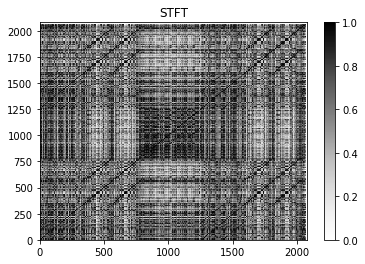

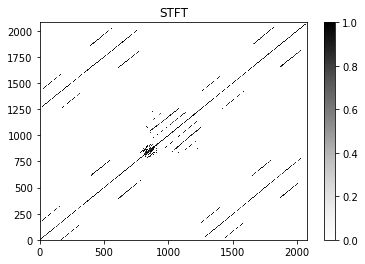

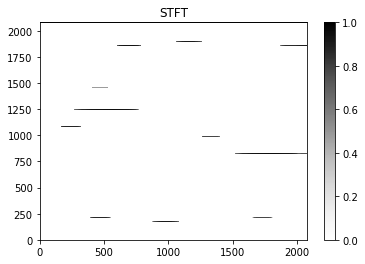

In [8]:
_, _, x = signal.stft(song, nperseg=8192, nfft=8192)  # 1792/1920
x = abs(x)

x = spectral.log_spec(x)

x = spectral.chromagram(x)

dist = cdist(x.T, x.T, metric='cosine')
# dist = dist/np.max(dist)
dist = 1 - dist
dist[np.isnan(dist)] = 0

footie = np.zeros(shape=(100, 100))
np.fill_diagonal(footie, 1)

spectral.display(dist)

mask = median_filter(abs(dist), footprint=footie)
mask[mask < .88] = 0
mask[mask > 0] = 1
dist = dist*mask


spectral.display(dist)


l = structure.sim_to_lag(dist)
l = median_filter(abs(l), size=(1, 250))
spectral.display(l)

energy = np.zeros(shape=len(l))
for frame in range(0, len(l)-1):
    energy[frame] = np.linalg.norm(l[:, frame+1]) - np.linalg.norm(l[:, frame])

import matplotlib.pyplot as plt
# plt.plot(abs(energy))
# plt.show()

peaks, _ = signal.find_peaks(abs(energy), height=np.mean(energy), distance=100)



In [9]:
tmp = energy.copy()
energy = tmp.copy()

energy = np.zeros(shape=len(l))
for frame in range(0, len(l)-1):
    energy[frame] = np.linalg.norm(l[:, frame+1]) - np.linalg.norm(l[:, frame])

In [10]:
def moving_average(data_set, periods=3):
    weights = np.ones(periods) / periods
    return np.convolve(data_set, weights, mode='valid')

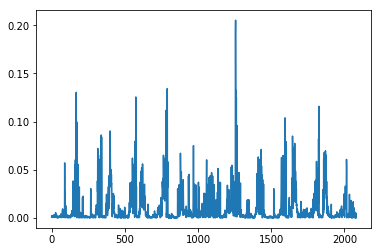

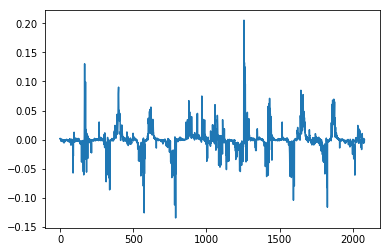

In [12]:
plt.plot(abs(energy))
plt.show()
plt.plot(energy)
plt.show()

In [13]:
from song import beat
def split_pos(arr):
    pos = arr.copy()
    neg = arr.copy()
    pos[pos < 0] = 0
    neg[neg > 0] = 0
    return pos, abs(neg)
p,n = split_pos(energy)
# plt.plot(p)
# plt.show()
# plt.plot(n)
# plt.show()

63.074074074074076

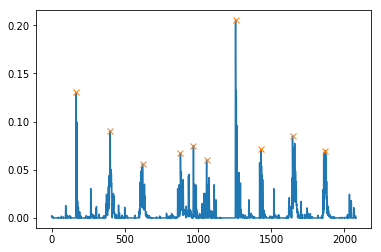

In [14]:
# energy = abs(energy)
ave = moving_average(energy, 40)
starts, _ = signal.find_peaks(p, distance=40, prominence=(0.04))
plt.plot(p)
# plt.plot(ave)
# plt.axhline(y=np.mean(energy))
plt.plot(starts, p[starts], "x")
peakdist = np.mean(np.diff(starts))/3
peakdist

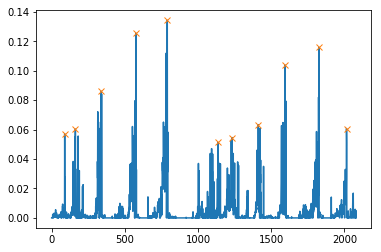

In [15]:
# energy = abs(energy)
# ave = moving_average(energy, 40)
ends, _ = signal.find_peaks(n, distance=peakdist, prominence=(0.04))
plt.plot(n)
# plt.plot(ave)
# plt.axhline(y=np.mean(energy))
plt.plot(ends, n[ends], "x")

In [16]:
def remove_short(starts, ends):
    to_del = []
    for i in range(len(starts)):
        for j in range(len(ends)):
            if abs(starts[i] - ends[j]) < 40:
                to_del.append(j)
    ends = np.delete(ends, to_del)
    return starts, ends

print(len(starts), len(ends))
starts, ends = remove_short(starts, ends)
print(len(starts), len(ends))


10 11
10 8


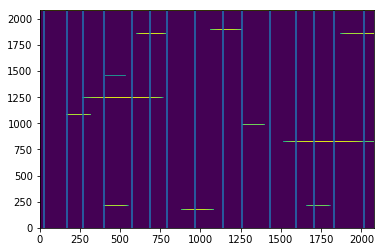

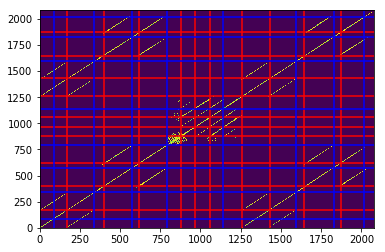

In [17]:
plt.pcolormesh(l)
for xc in peaks:
    plt.axvline(x=xc)

plt.show()

plt.pcolormesh(dist)
for start in starts:
    plt.axvline(x=start, color="red")
    plt.axhline(y=start, color="red")

for end in ends:
    plt.axvline(x=end, color="blue")
    plt.axhline(y=end, color="blue")

plt.show()

In [17]:
def merge(a, b):
    c = np.concatenate((a,b))
    c.sort(kind='mergesort')
    return c

In [19]:
peaks = merge(starts, ends)
srpeaks = peaks * 4096
print(len(peaks))

19


In [20]:
peaks, np.diff(srpeaks/sr)

(array([  12,   89,  173,  337,  400,  575,  620,  791,  881,  929, 1060,
        1136, 1256, 1433, 1595, 1643, 1825, 1872, 2014], dtype=int64),
 array([ 7.15174603,  7.80190476, 15.23229025,  5.85142857, 16.25396825,
         4.17959184, 15.88244898,  8.35918367,  4.45823129, 12.16725624,
         7.05886621, 11.14557823, 16.43972789, 15.04653061,  4.45823129,
        16.90412698,  4.36535147, 13.18893424]))

In [21]:
len(song)/sr

193.14358276643992

In [22]:
clips = []
clips.append(song[0:srpeaks[0]])
clips += [song[srpeaks[i]:srpeaks[i+1]] for i in range(1,len(srpeaks)-1)]
clips += [song[srpeaks[-1]:]]

In [23]:
for clip in clips:
    IPython.display.display(Audio(clip, rate=sr))

In [24]:
len(clips)
for clip in clips:
    print(len(clip))

49152
344064
671744
258048
716800
184320
700416
368640
196608
536576
311296
491520
724992
663552
196608
745472
192512
581632
268288


In [25]:
peaks

array([  12,   89,  173,  337,  400,  575,  620,  791,  881,  929, 1060,
       1136, 1256, 1433, 1595, 1643, 1825, 1872, 2014], dtype=int64)

In [26]:
first = 0
segments = []
for point in peaks:
    segments.append((first, point))
    first = point

In [27]:
segments

[(0, 12),
 (12, 89),
 (89, 173),
 (173, 337),
 (337, 400),
 (400, 575),
 (575, 620),
 (620, 791),
 (791, 881),
 (881, 929),
 (929, 1060),
 (1060, 1136),
 (1136, 1256),
 (1256, 1433),
 (1433, 1595),
 (1595, 1643),
 (1643, 1825),
 (1825, 1872),
 (1872, 2014)]

In [28]:
segmented = []
for a,b in segments:
    segmented.append(l[:, a:b])

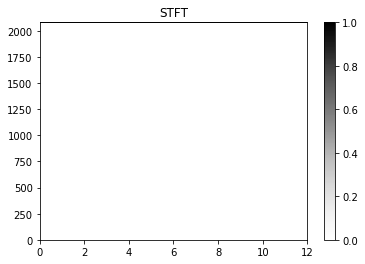

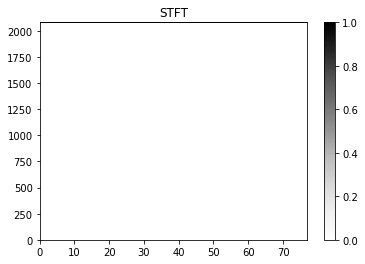

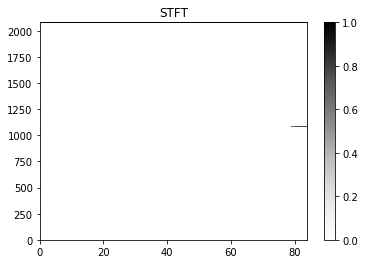

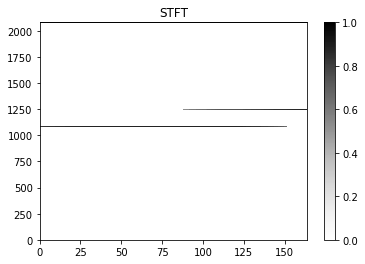

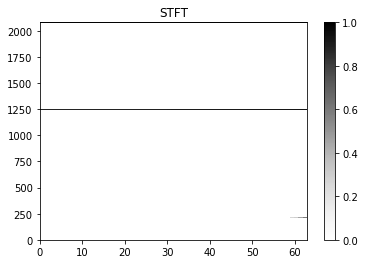

...

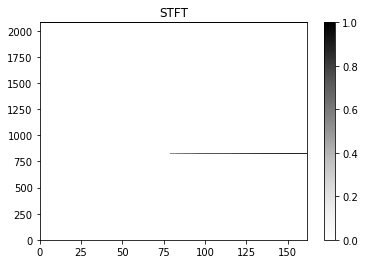

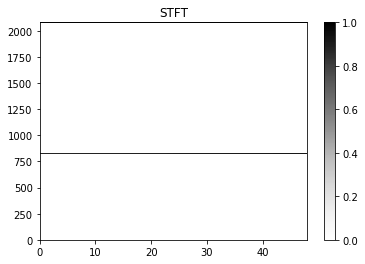

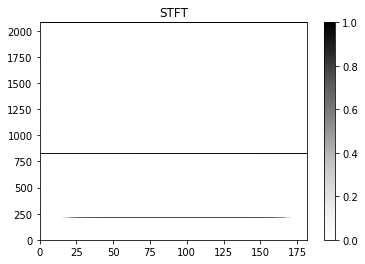

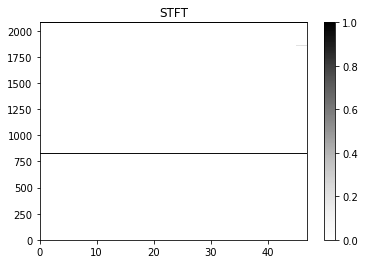

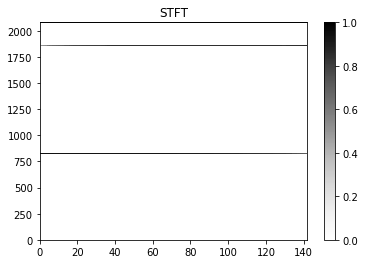

In [29]:
for m in segmented:
    spectral.display(m)

In [34]:
sims = np.zeros(shape=(len(segmented),len(segmented)))

In [32]:
def reshape(x, y):
    if x.shape[1] < y.shape[1]:
        padded = np.empty(shape=y.shape)
        padded[:x.shape[0],:x.shape[1]] = x
        return padded, y
    elif x.shape[1] > y.shape[1]:
        padded = np.empty(shape=x.shape)
        padded[:y.shape[0],:y.shape[1]] = y
        return x, padded
    else:
        return x, y

In [35]:
for i in range(len(segmented)):
    for j in range(len(segmented)):
        new1, new2 = reshape(segmented[i], segmented[j])
        sims[i, j] =compare_ssim(new1, new2)

In [43]:
t.shape ,  segmented[1].shape

NameError: name 't' is not defined

In [171]:
import scipy

In [181]:
scipy.spatial.distance.pdist?

In [49]:
scipy.spatial.distance.euclidean?

In [30]:
from skimage.measure import compare_ssim
from skimage.measure import compare_mse

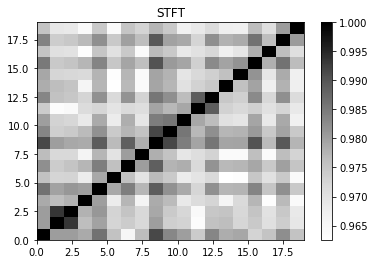

In [37]:
spectral.display((sims/np.max(sims)))